In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.keras.regularizers import l2
from google.colab import files
import cv2

In [ ]:
train = ImageDataGenerator(rescale=1/255,rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
test = ImageDataGenerator(rescale=1/255)

In [ ]:
train_dir = '/content/drive/My Drive/CNN_BINARY_CLASSIFICATION/train'
test_dir = '/content/drive/My Drive/CNN_BINARY_CLASSIFICATION/test'

In [ ]:
train_dataset = train.flow_from_directory(train_dir,
                                          target_size=(200,200),
                                          class_mode = 'binary')

test_dataset = test.flow_from_directory(test_dir,
                                          target_size=(200,200),
                                          class_mode = 'binary')

Found 1802 images belonging to 2 classes.
Found 217 images belonging to 2 classes.


In [ ]:
model = keras.Sequential()
model.add(keras.layers.Conv2D(32,(3,3),activation='relu',input_shape=(200,200,3)))
model.add(keras.layers.BatchNormalization())

model.add(keras.layers.MaxPool2D(2,2))
model.add(keras.layers.Dropout(0.3))

model.add(keras.layers.Conv2D(64,(3,3),activation='relu'))
model.add(keras.layers.BatchNormalization())

model.add(keras.layers.MaxPool2D(2,2))
model.add(keras.layers.Dropout(0.3))

model.add(keras.layers.Conv2D(128,(3,3),activation='relu'))
model.add(keras.layers.BatchNormalization())

model.add(keras.layers.MaxPool2D(2,2))
model.add(keras.layers.Dropout(0.4))

model.add(keras.layers.Conv2D(128,(3,3),activation='relu'))
model.add(keras.layers.BatchNormalization())

model.add(keras.layers.MaxPool2D(2,2))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(512,activation='relu',kernel_regularizer=l2(0.01)))
model.add(keras.layers.Dense(1,activation='sigmoid'))

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])

In [ ]:
from tensorflow.keras.callbacks import ReduceLROnPlateau

lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1)


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


In [ ]:
model.fit(train_dataset,
         steps_per_epoch = 30,
         epochs = 10,
         validation_data = test_dataset,
          callbacks=[early_stopping, lr_scheduler])

Epoch 1/10
30/30 ━━━━━━━━━━━━━━━━━━━━ 19s 503ms/step - accuracy: 0.9371 - loss: 0.3585 - val_accuracy: 0.8571 - val_loss: 0.5457 - learning_rate: 3.9063e-06
Epoch 2/10
30/30 ━━━━━━━━━━━━━━━━━━━━ 9s 305ms/step - accuracy: 0.9232 - loss: 0.3400 - val_accuracy: 0.8571 - val_loss: 0.5527 - learning_rate: 3.9063e-06
Epoch 3/10
30/30 ━━━━━━━━━━━━━━━━━━━━ 31s 499ms/step - accuracy: 0.9229 - loss: 0.3362 - val_accuracy: 0.8571 - val_loss: 0.5484 - learning_rate: 3.9063e-06
Epoch 4/10
27/30 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step - accuracy: 0.9406 - loss: 0.3414
Epoch 4: ReduceLROnPlateau reducing learning rate to 1.9531250927684596e-06.
30/30 ━━━━━━━━━━━━━━━━━━━━ 9s 303ms/step - accuracy: 0.9414 - loss: 0.3387 - val_accuracy: 0.8571 - val_loss: 0.5581 - learning_rate: 3.9063e-06
Epoch 5/10
30/30 ━━━━━━━━━━━━━━━━━━━━ 19s 524ms/step - accuracy: 0.9382 - loss: 0.3404 - val_accuracy: 0.8525 - val_loss: 0.5710 - learning_rate: 1.9531e-06


SAVING THE MODEL

In [ ]:
os.chdir('/content/drive/My Drive/CNN_BINARY_CLASSIFICATION/')

In [ ]:
tf.keras.models.save_model(model,'cheetah_jaguar_binary_op1.keras')

In [ ]:

files.download('cheetah_jaguar_binary_op1.keras')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from pickle import load
model= load_model('/content/drive/My Drive/CNN_BINARY_CLASSIFICATION/cheetah_jaguar_binary_op1.keras')

In [ ]:
def predicts(filename, model):


    img = cv2.imread(filename)

    img_resized = cv2.resize(img, (200, 200))


    plt.imshow(img_resized)


    img_array = np.array(img_resized, dtype=np.float32) / 255.0
    img_array = np.expand_dims(img_array, axis=0)


    val = model.predict(img_array)[0][0]
    print(val)

    if val >= 0.5:
        plt.xlabel("A Jaguar", fontsize=16)
    else:
        plt.xlabel("A Cheetah", fontsize=16)

    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
0.1820579


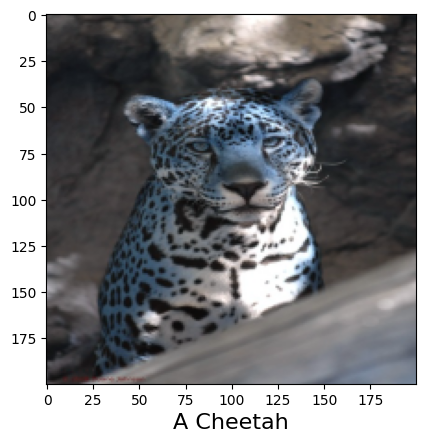

In [ ]:
predicts('/content/drive/My Drive/CNN_BINARY_CLASSIFICATION/train/jaguar_train_resized/jaguar_178_resized.jpg',model)

BATCH PREDICTIONS

In [ ]:
def batch_predict(directory, model):
 for root, _, files in os.walk(directory):
        if not files:
            continue

        print(f"Processing folder: {root}")

        for file in files:
            if file.endswith(('.jpg', '.png', '.jpeg')):
                filepath = os.path.join(root, file)


                img = cv2.imread(filepath)

                img_resized = cv2.resize(img, (200, 200))


                plt.imshow(img_resized)


                img_array = np.array(img_resized, dtype=np.float32) / 255.0
                img_array = np.expand_dims(img_array, axis=0)

                val = model.predict(img_array)[0][0]
                print(val)

                if val >= 0.5:
                   plt.xlabel(f"Predicted: Jaguar\nFile: {file}", fontsize=12)
                else:
                    plt.xlabel(f"Predicted: Cheetah\nFile: {file}", fontsize=12)
                plt.show()




In [ ]:
directory_path = r'/content/drive/My Drive/CNN_BINARY_CLASSIFICATION/test/jaguar_validation_resized'
batch_predict(directory_path, model)

Processing folder: /content/drive/My Drive/CNN_BINARY_CLASSIFICATION/test/cheetah_validation_resized
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
0.0016242634


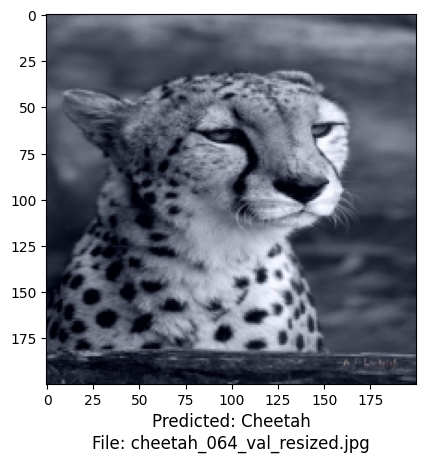

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
0.107021436


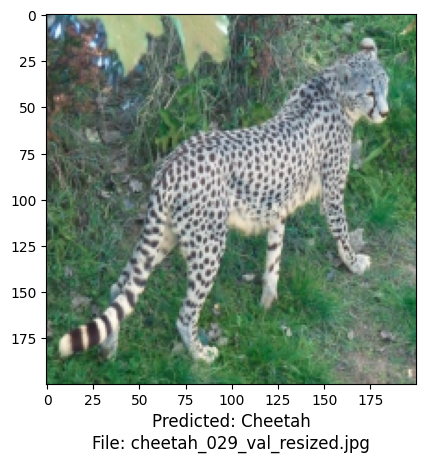

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
0.4340712


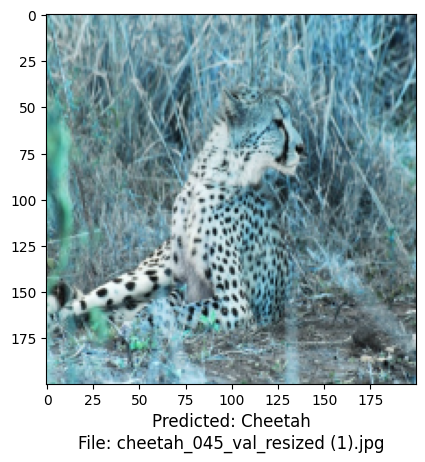

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
0.24568401


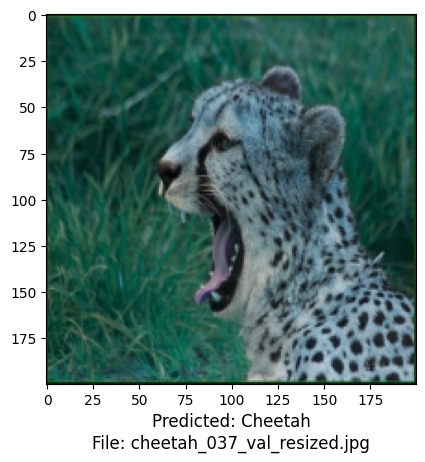

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
0.53543615


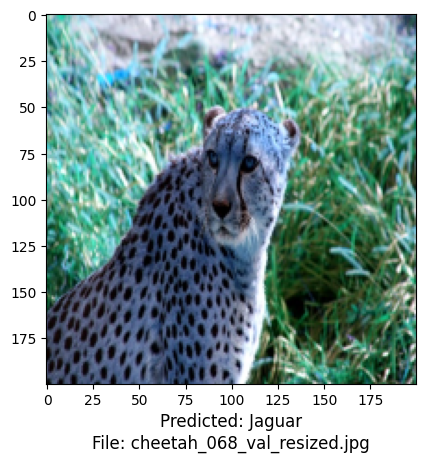

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
0.58908457


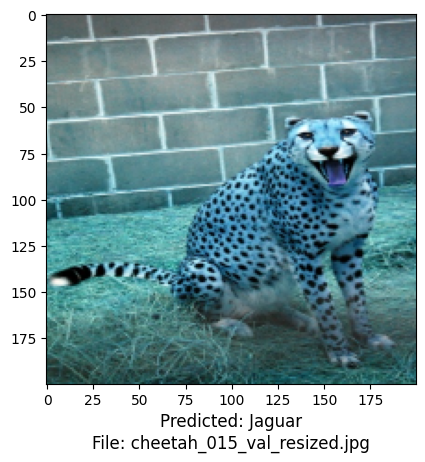

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
0.44901213


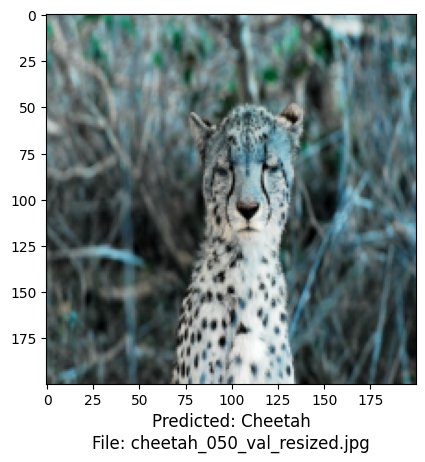

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
0.21668279


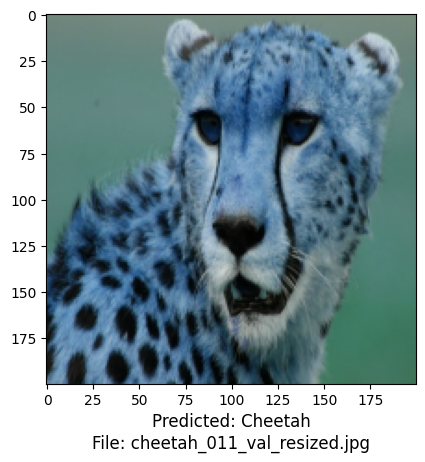

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
0.45338064


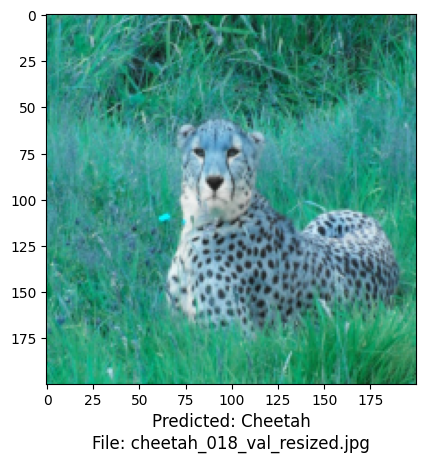

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
0.81931907


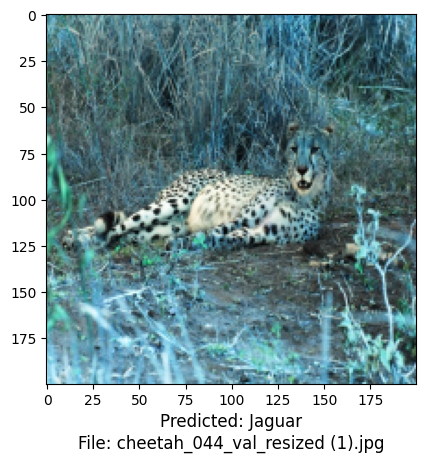

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
0.99810535


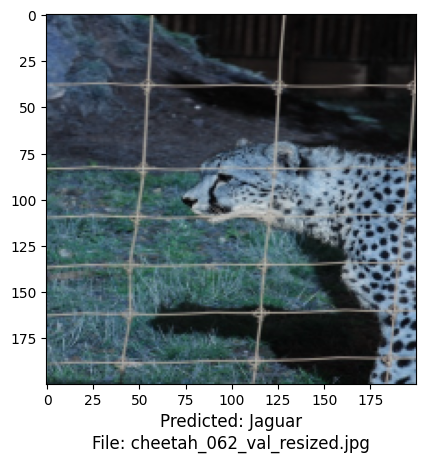

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
0.63425964


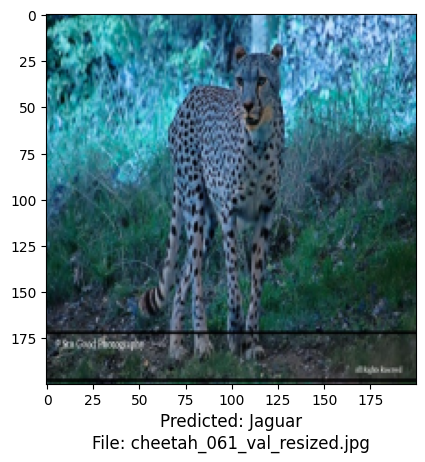

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
0.6611006


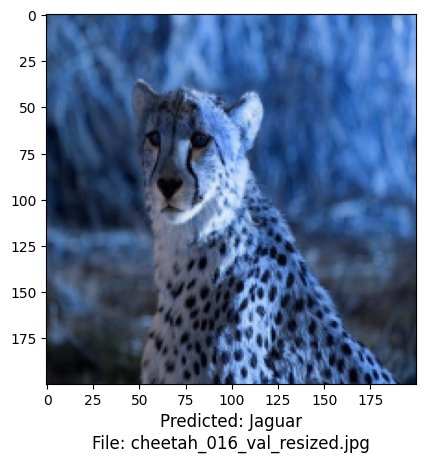

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
0.01132777


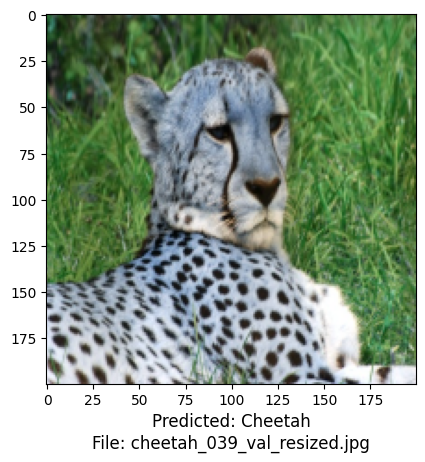

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
0.96145624


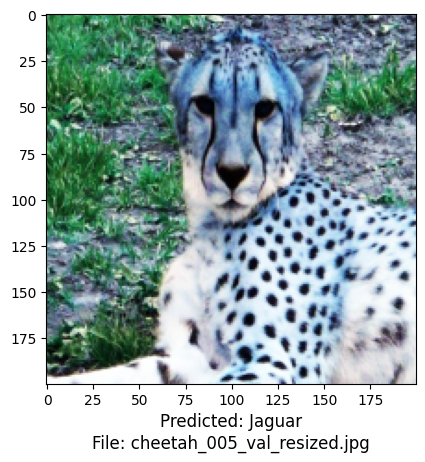

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
0.18322419


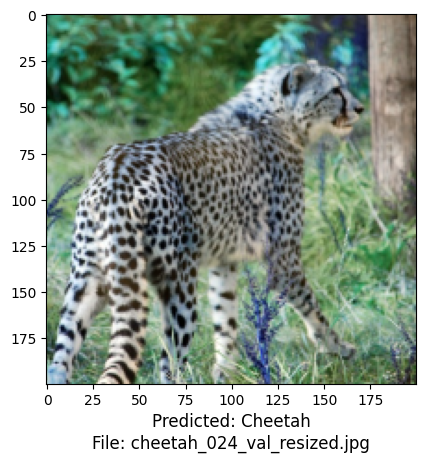

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
0.09549964


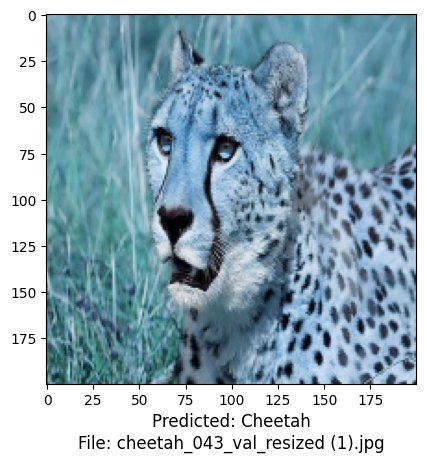

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
0.038183402


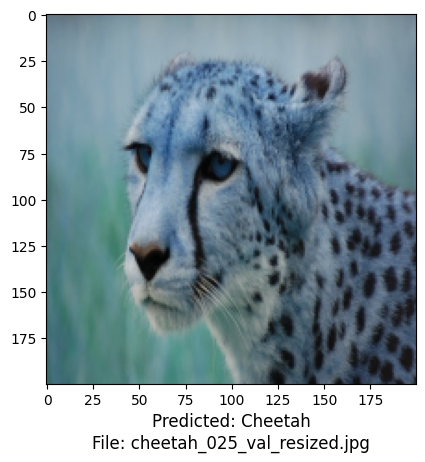

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
0.28069386


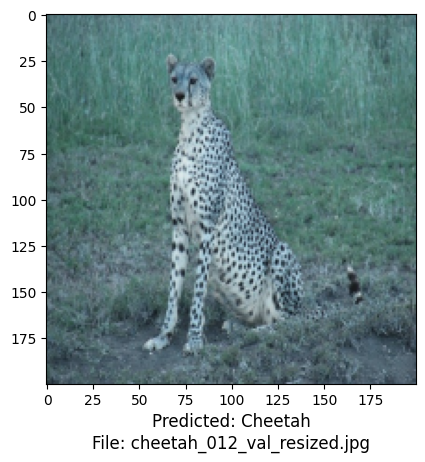

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
0.9910295


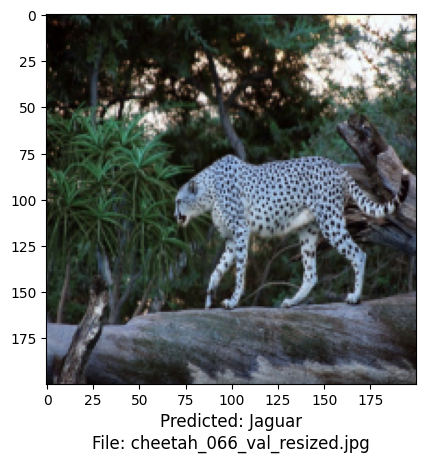

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
0.43260723


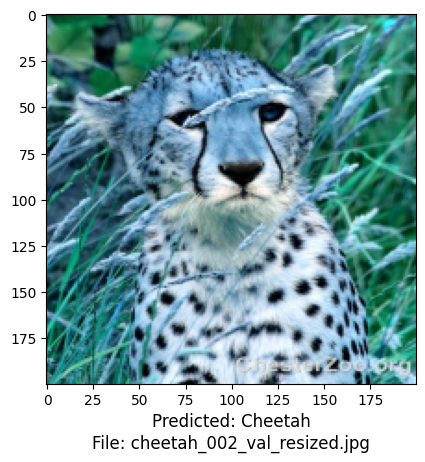

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
0.99543095


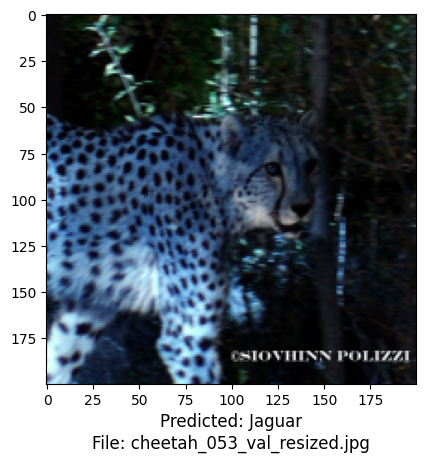

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
0.985299


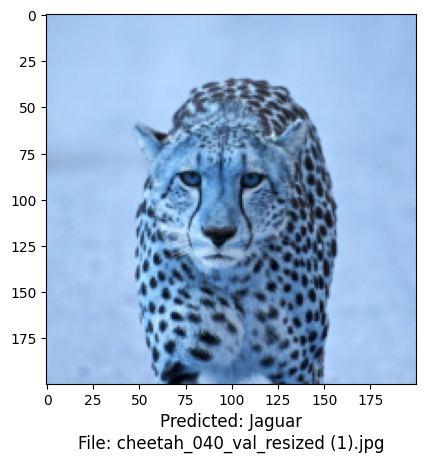

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
0.21258205


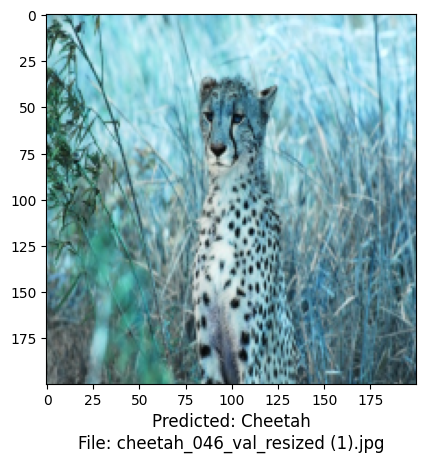

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
0.9467454


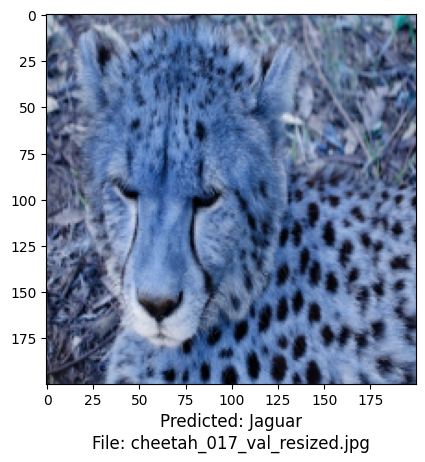

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
0.56012565


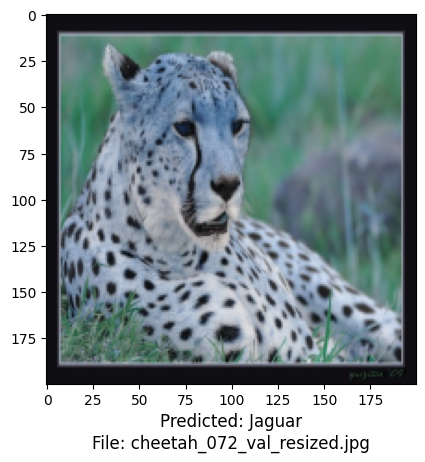

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
0.4340712


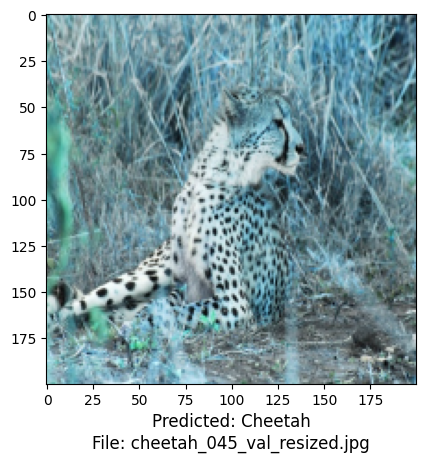

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
0.81931907


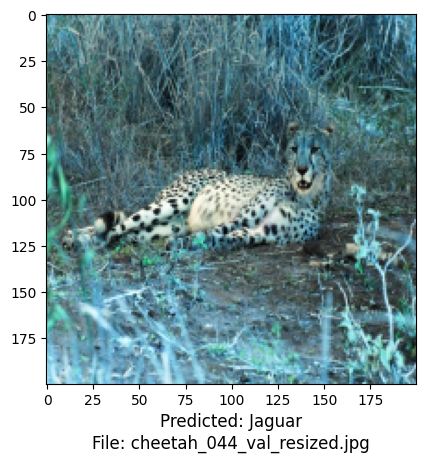

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
0.5078344


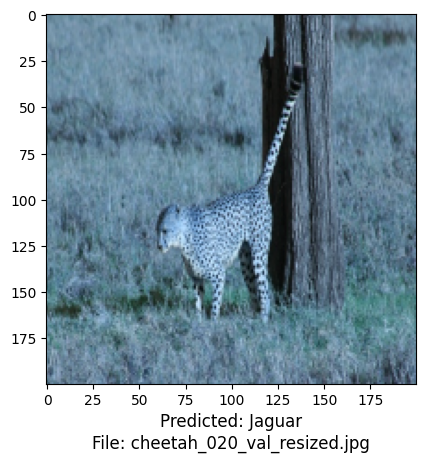

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
0.327128


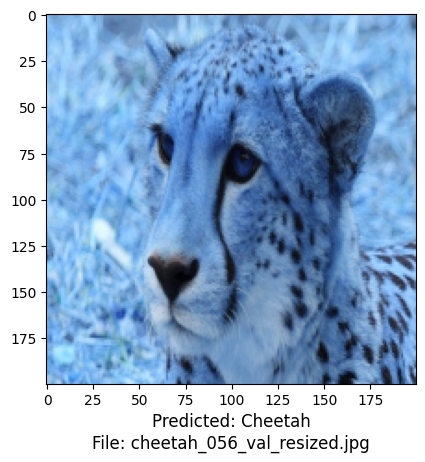

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
0.008207345


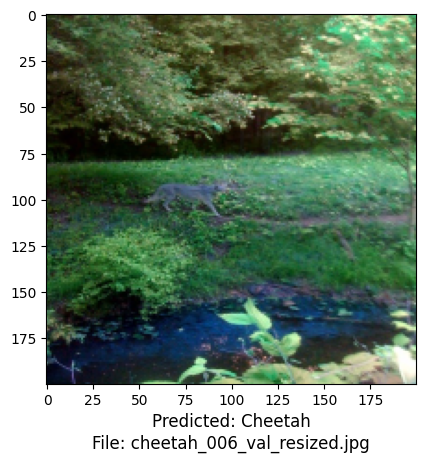

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
0.0016711337


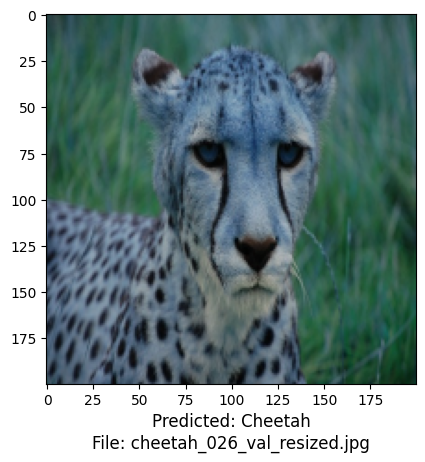

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
0.043614462


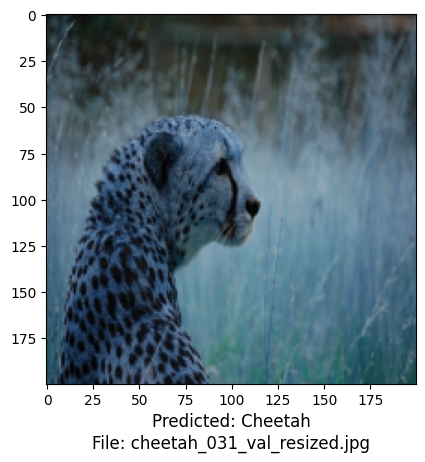

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
0.9852565


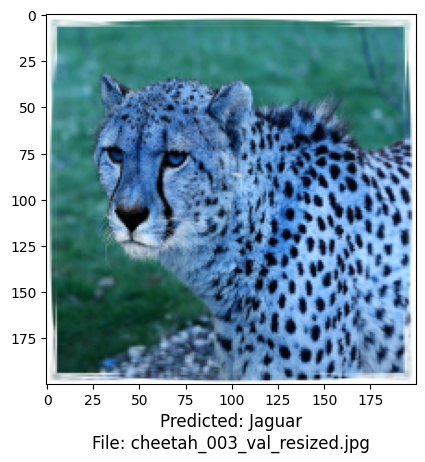

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
0.011574204


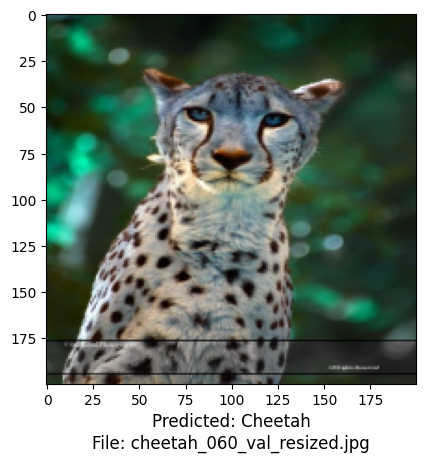

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
0.07570337


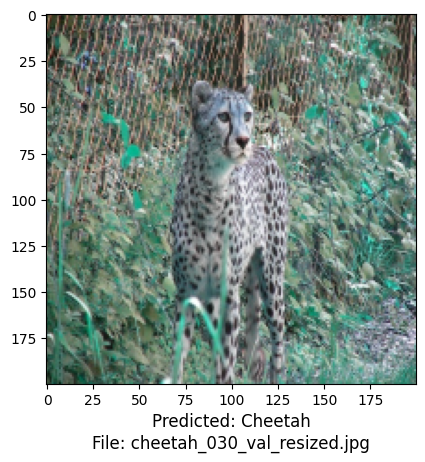

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
0.33279744


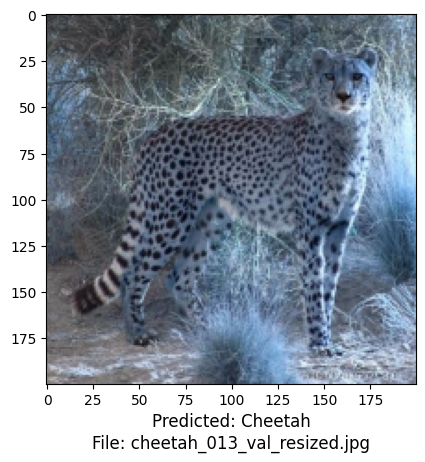

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
0.9558953


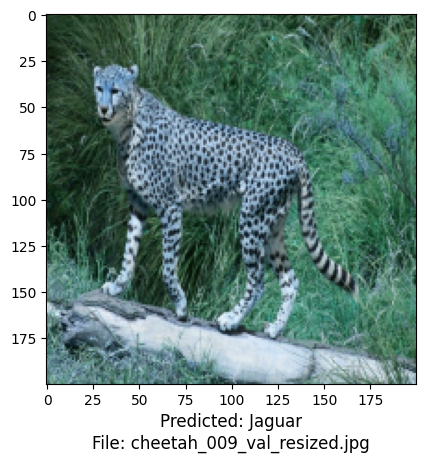

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
0.90046567


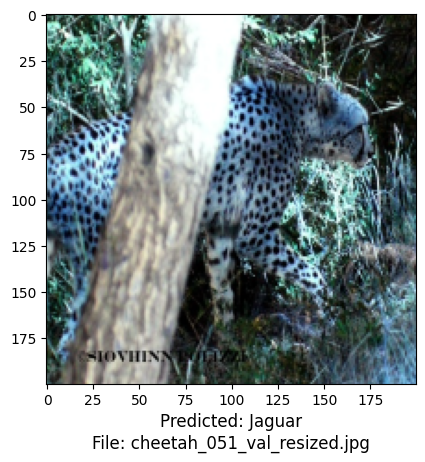

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
0.67665267


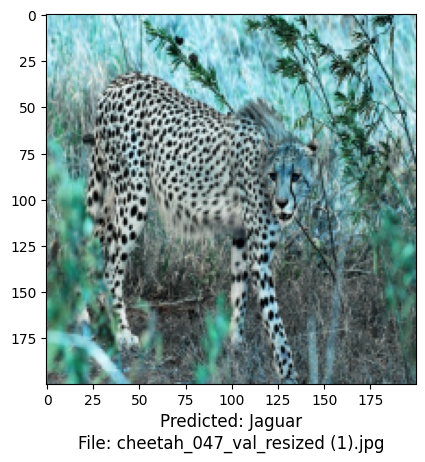

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
0.5212272


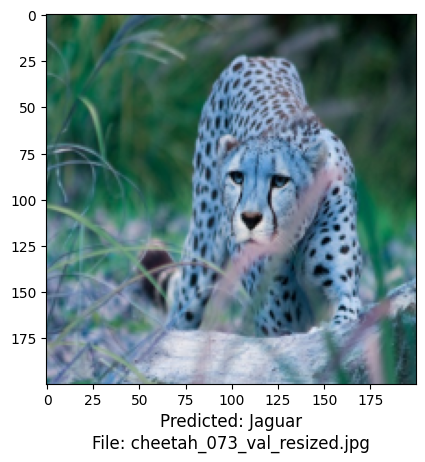

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.9301466


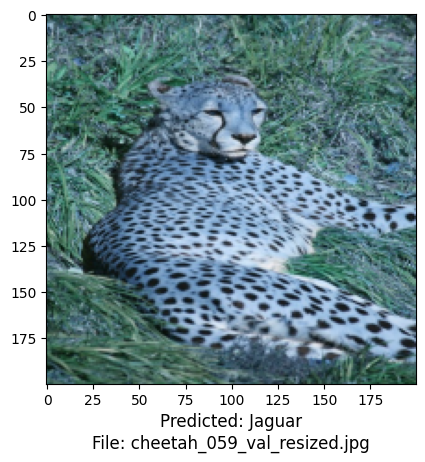

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
0.9158964


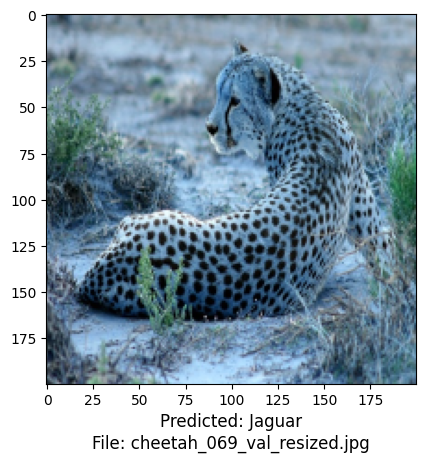

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
0.87375987


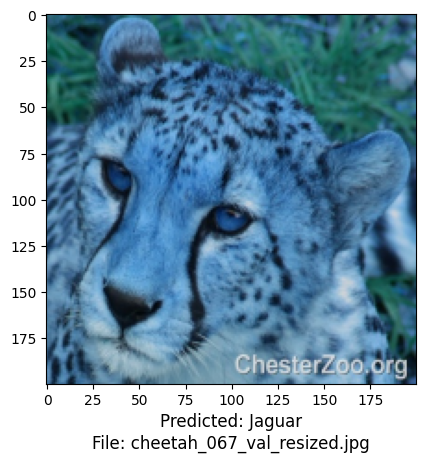

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
0.32020804


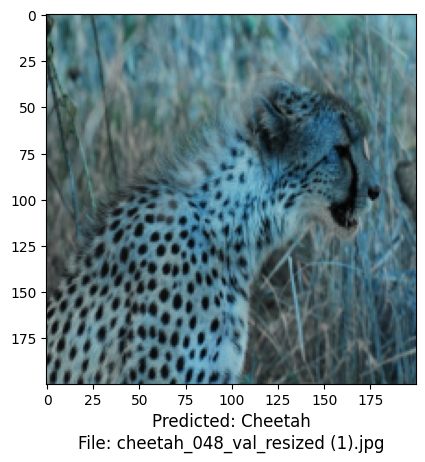

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
0.04527077


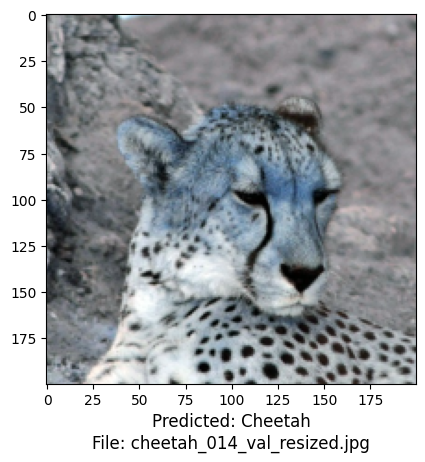

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
0.00054775336


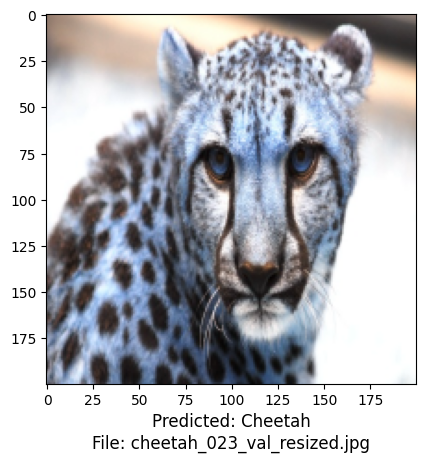

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
0.7522253


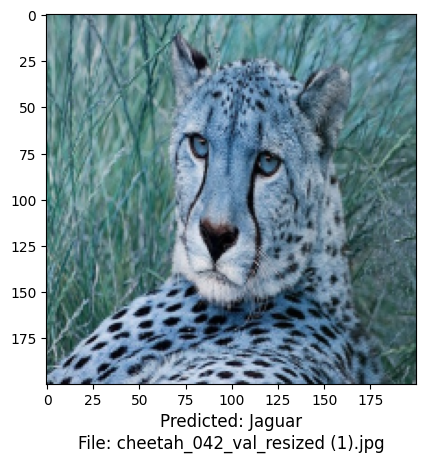

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.91924274


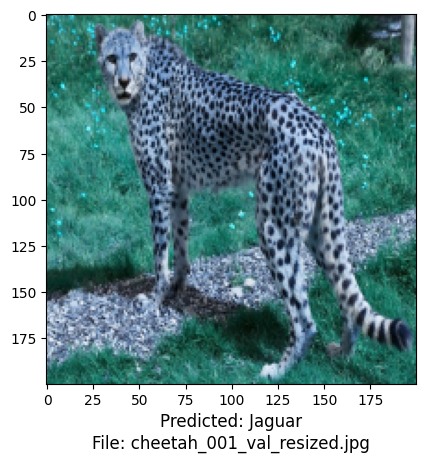

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
0.34075022


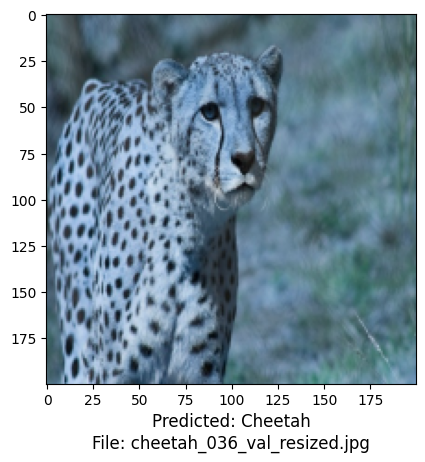

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
0.10256879


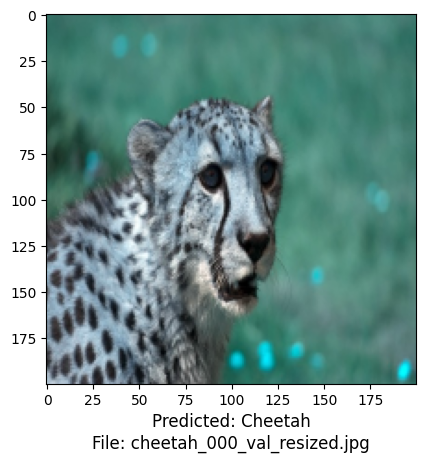

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
0.9413538


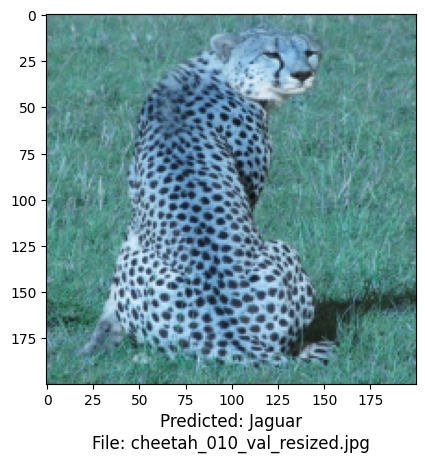

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
0.04212774


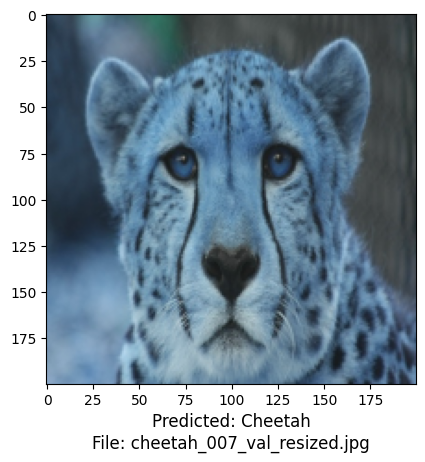

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
0.05937861


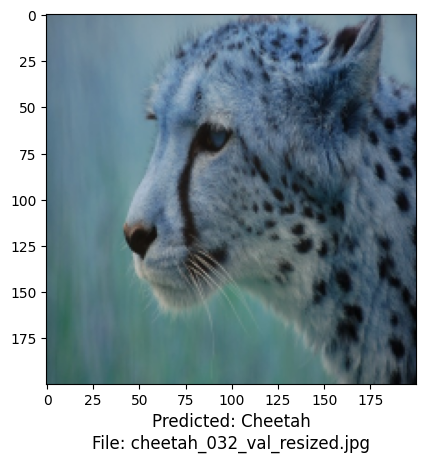

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
0.7070038


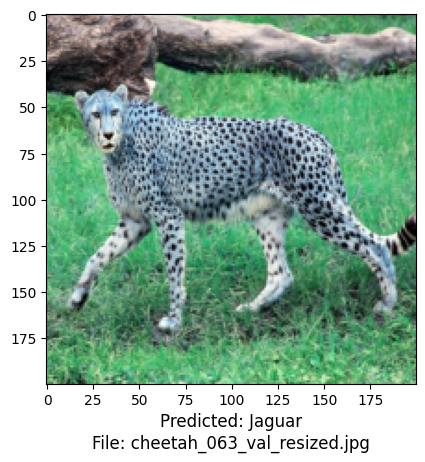

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
0.59521776


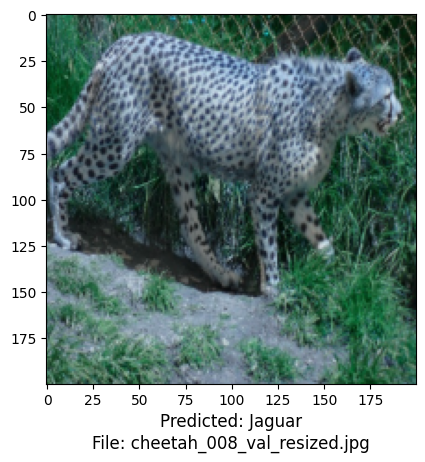

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
0.7522253


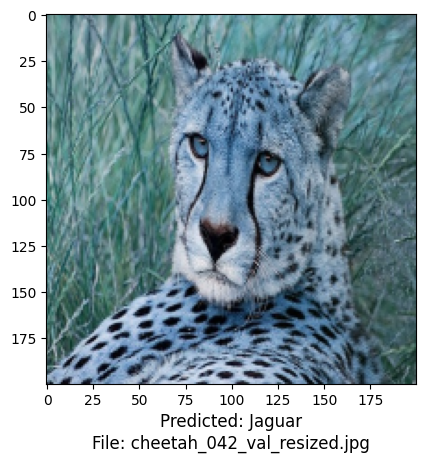

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
0.10511131


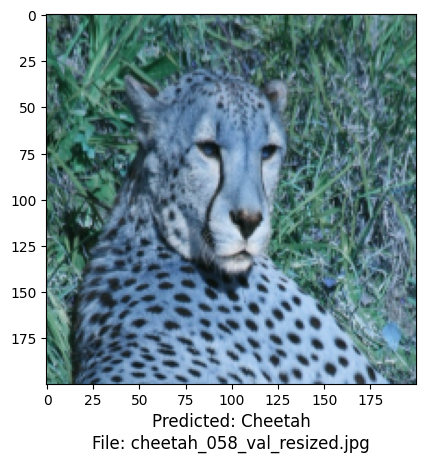

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
0.7662861


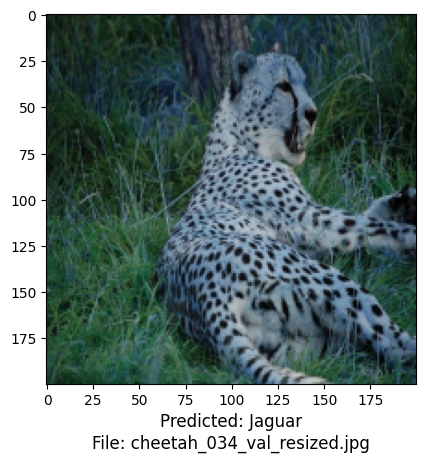

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
0.95526135


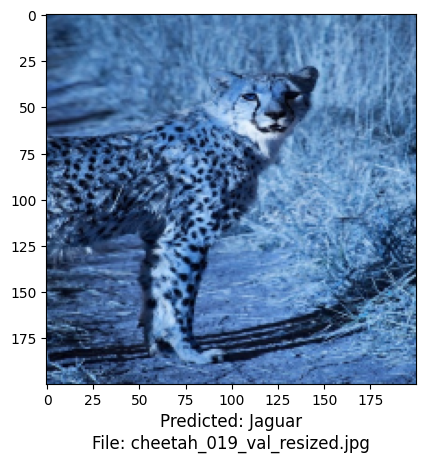

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
0.67665267


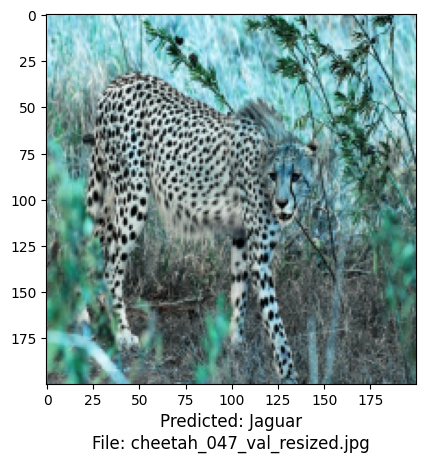

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
0.099428184


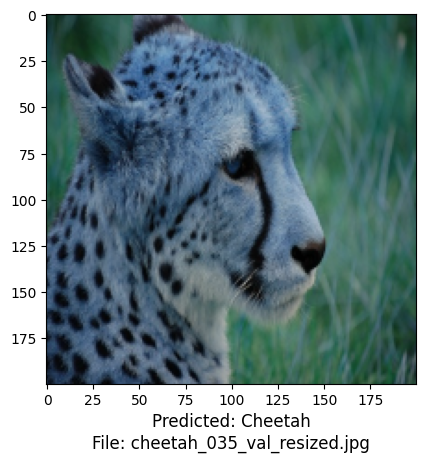

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
0.74812907


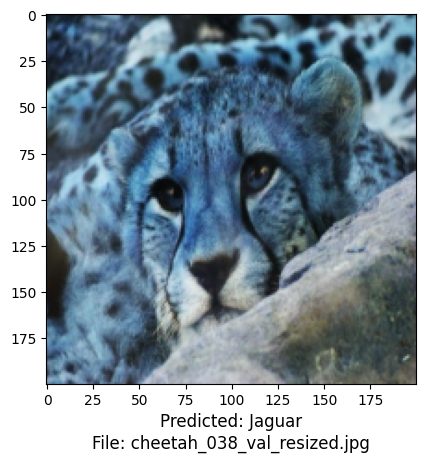

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
0.017267544


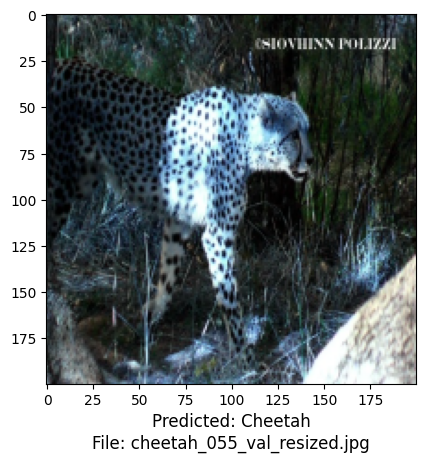

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
0.985299


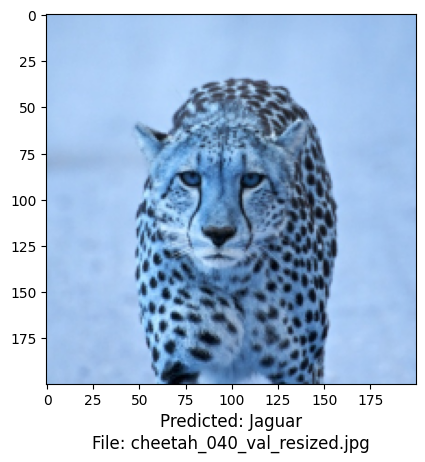

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
0.90991557


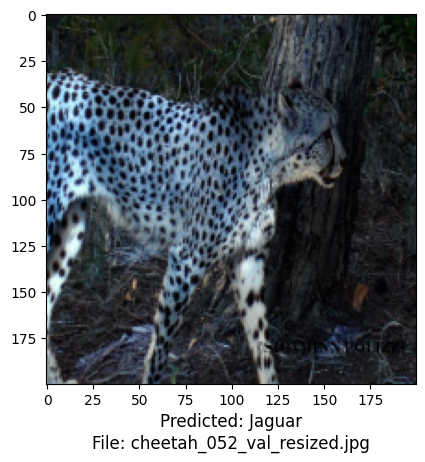

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
0.31922668


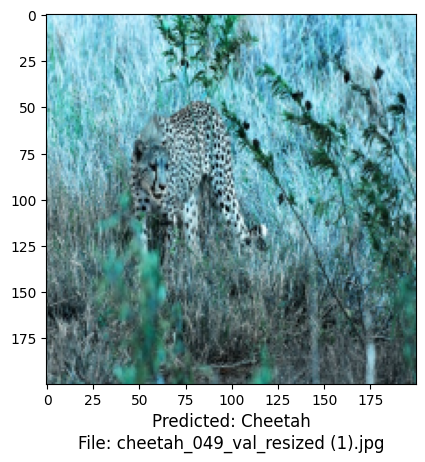

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
0.044902235


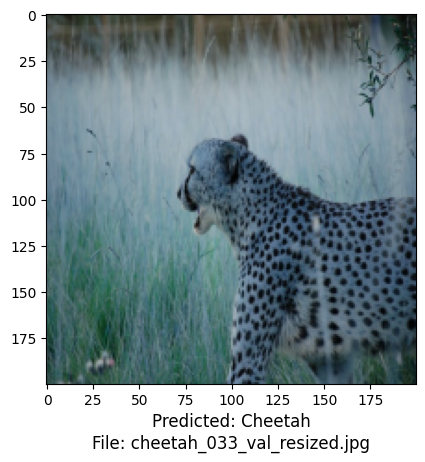

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
0.7479433


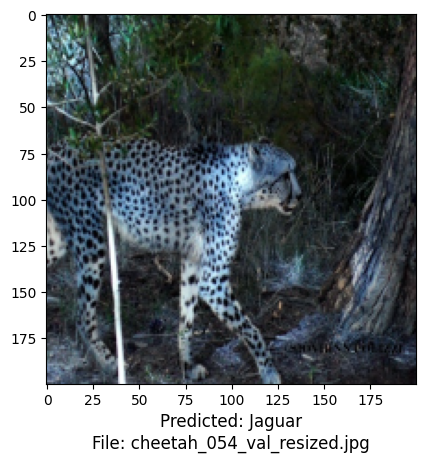

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
0.43536264


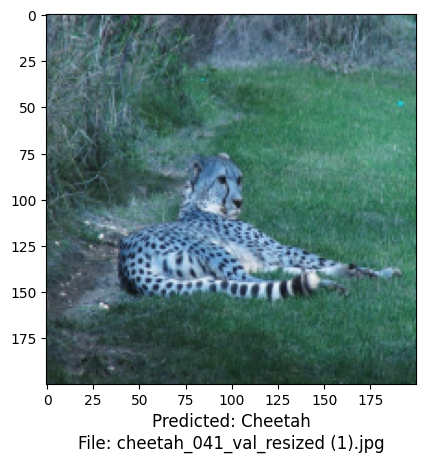

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.31922668


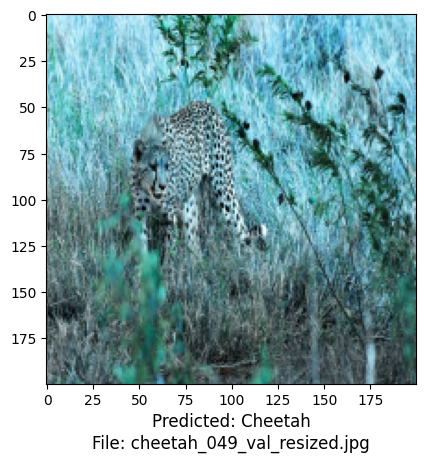

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.43536264


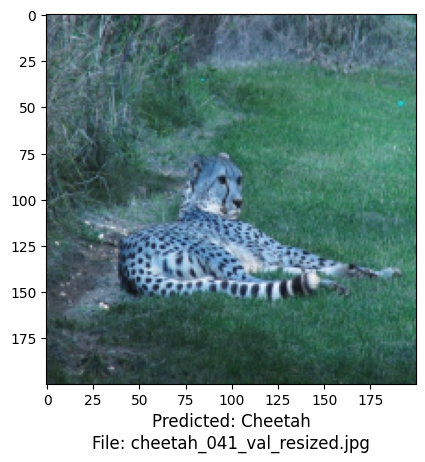

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
0.26114744


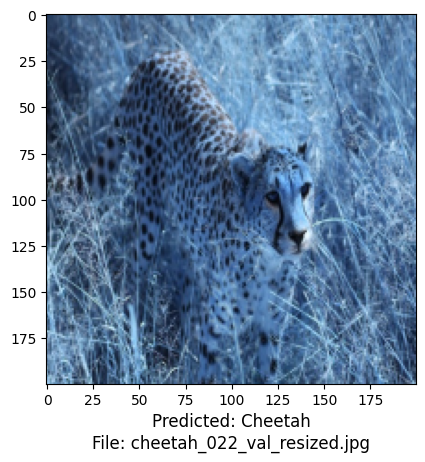

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.6914


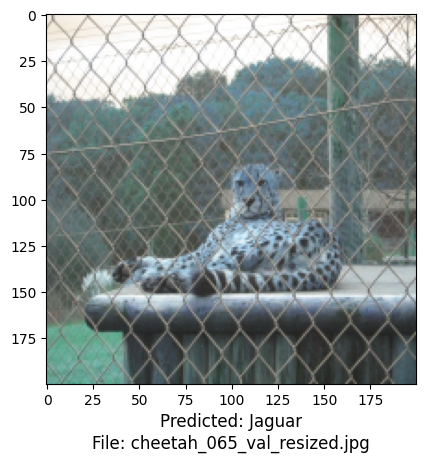

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
0.8402198


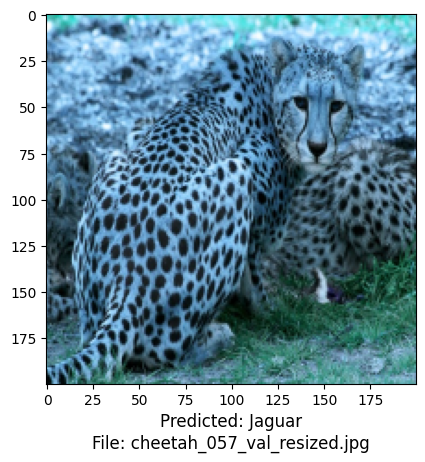

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
0.99768203


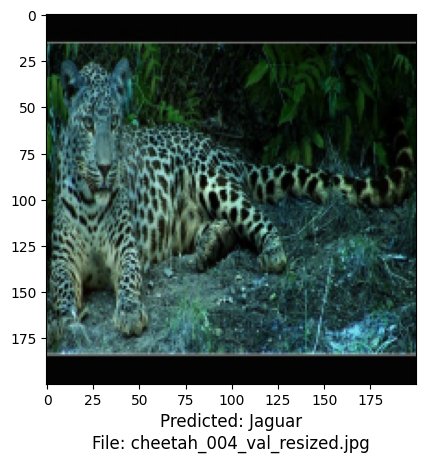

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
0.09549964


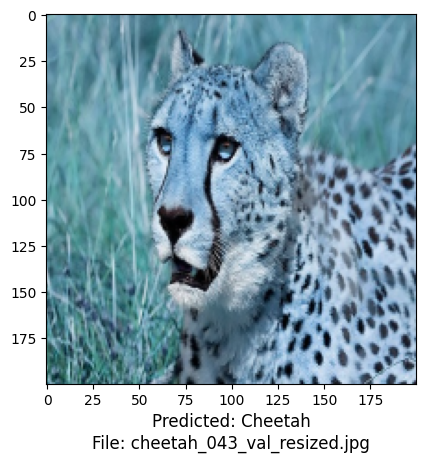

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
0.11546229


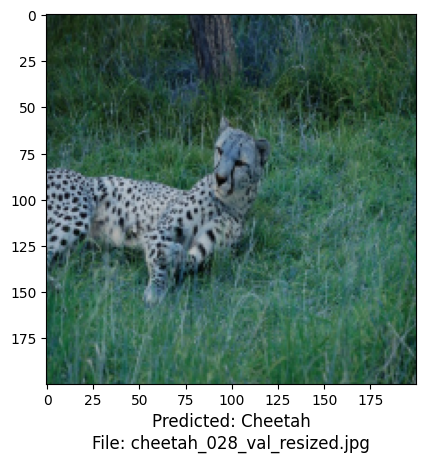

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.014562179


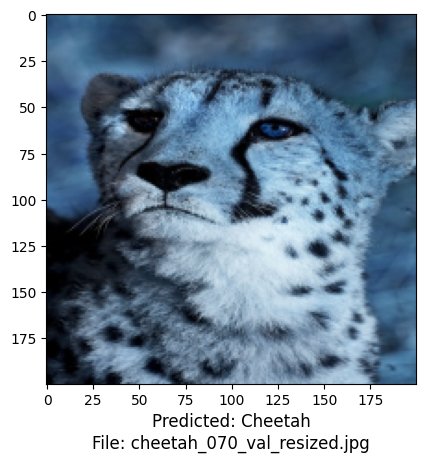

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
0.32020804


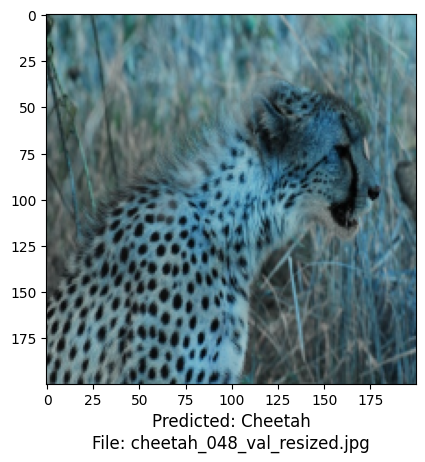

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
0.5719366


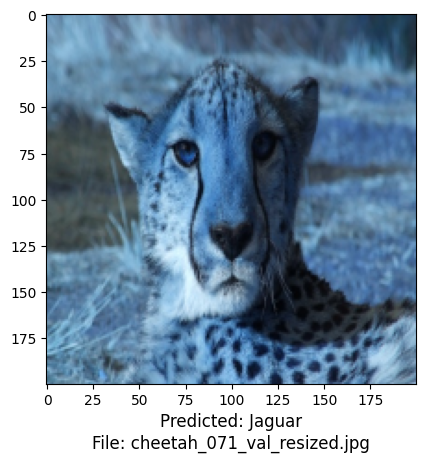

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
0.1507484


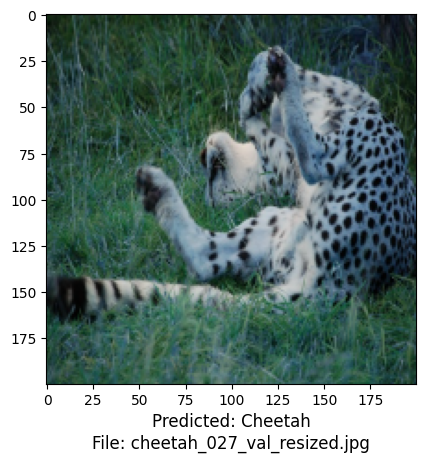

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
0.21258205


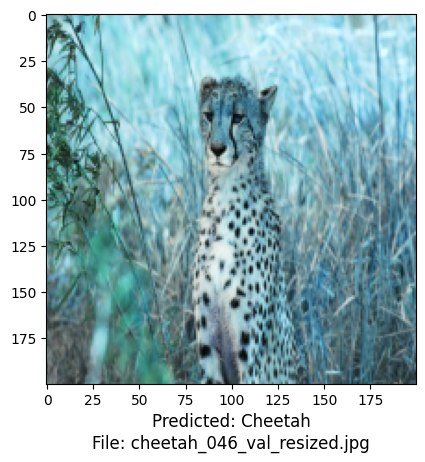

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
0.52924323


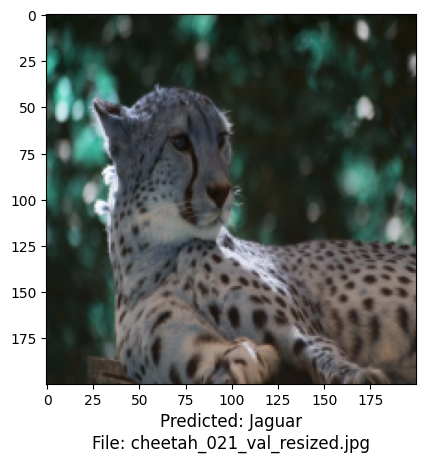

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
0.457009


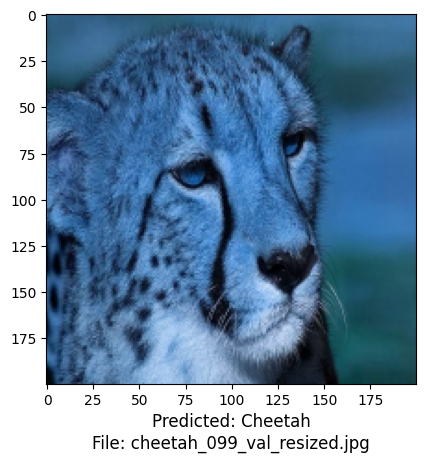

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
0.17794195


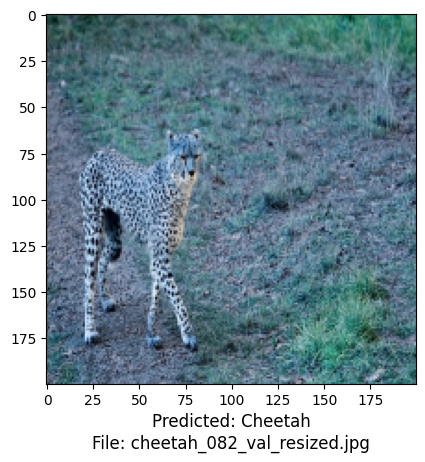

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
0.62337977


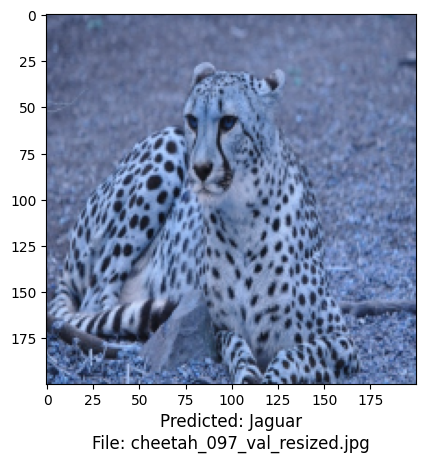

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
0.7245011


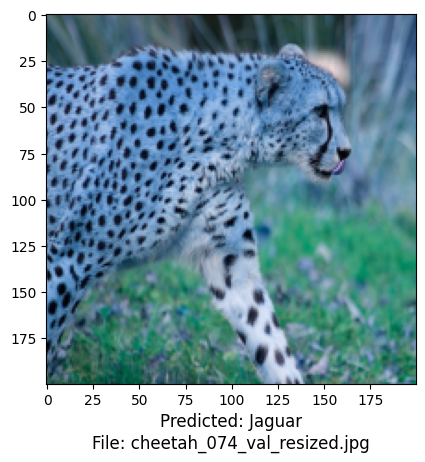

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
0.44278434


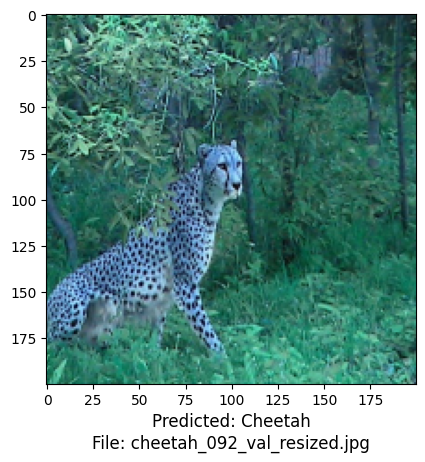

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
0.12638023


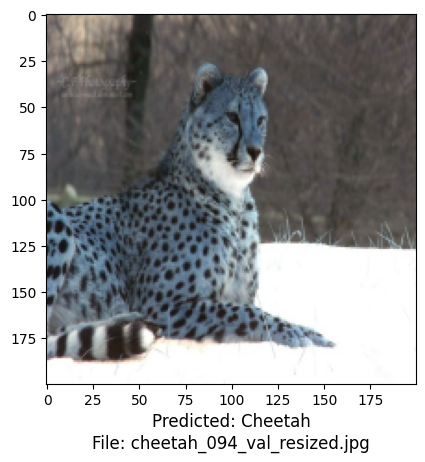

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
0.020176165


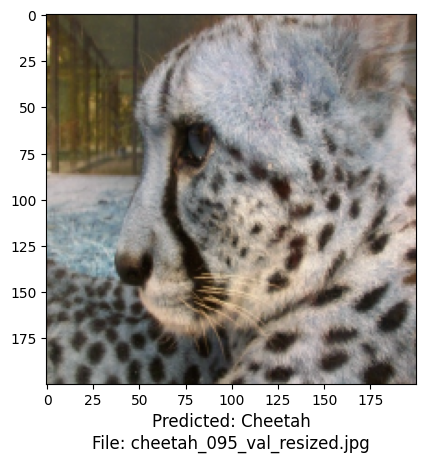

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
0.59156543


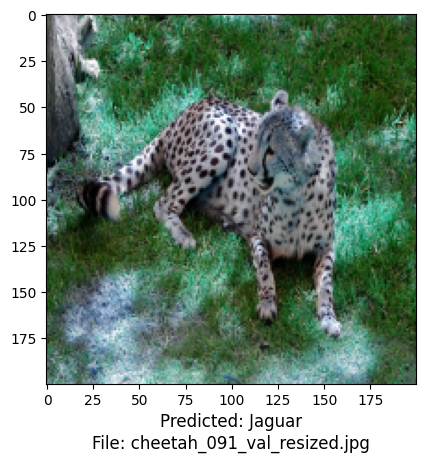

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
0.80746865


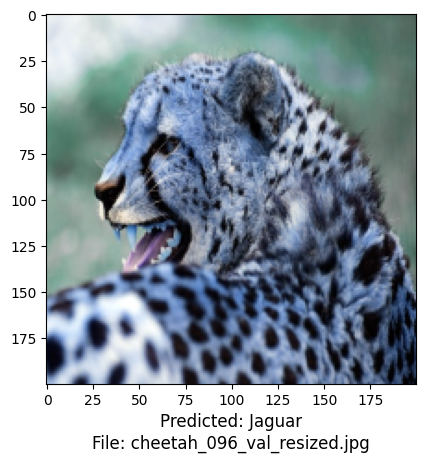

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
0.14219542


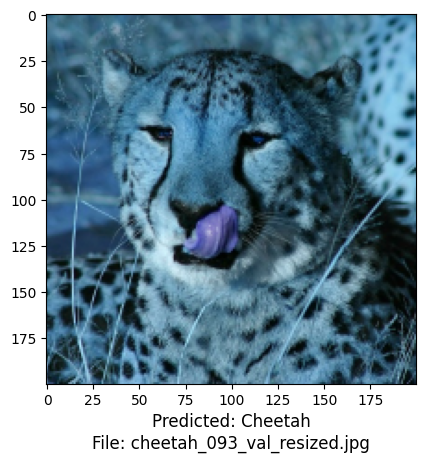

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.1150874


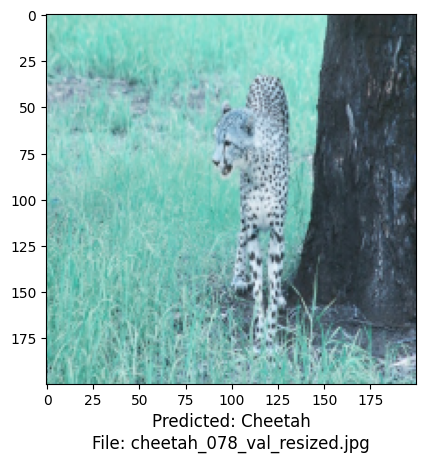

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
0.9878327


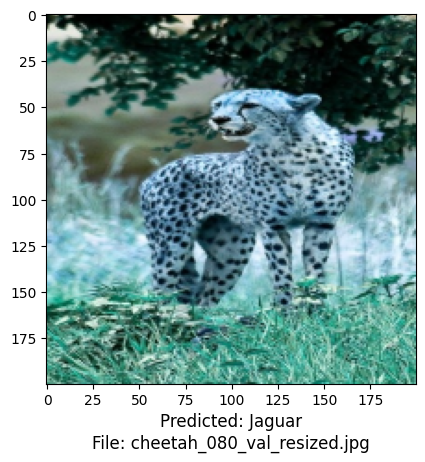

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
0.033811286


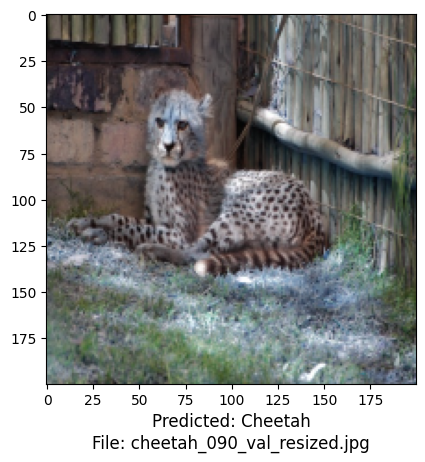

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
0.9383564


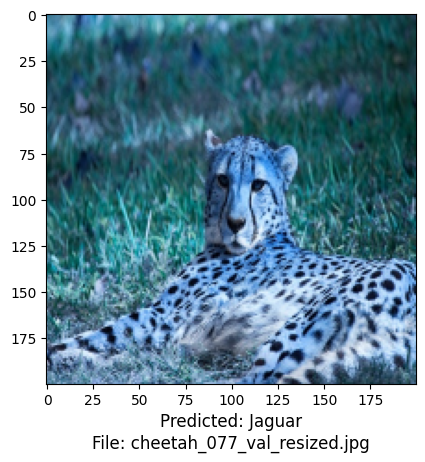

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
0.025132068


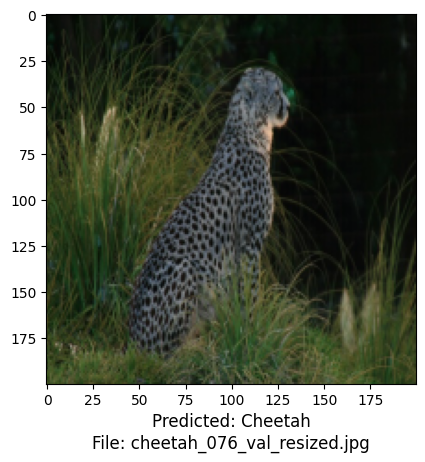

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
0.36608288


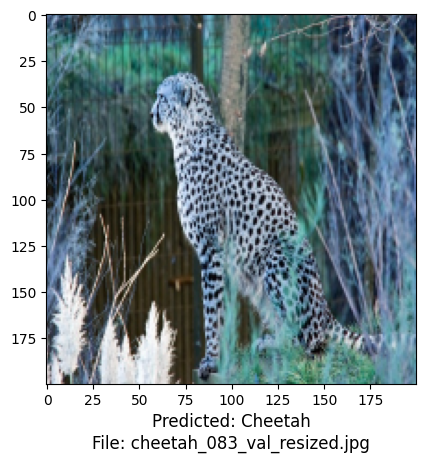

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
0.8335803


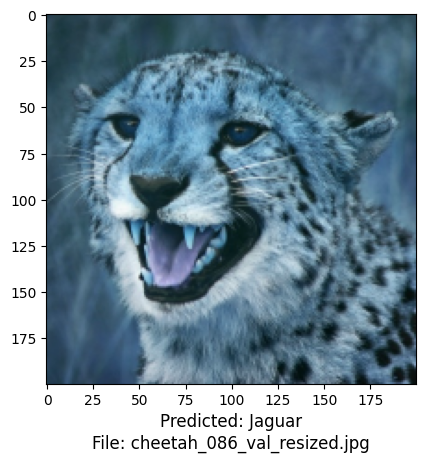

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
0.8548547


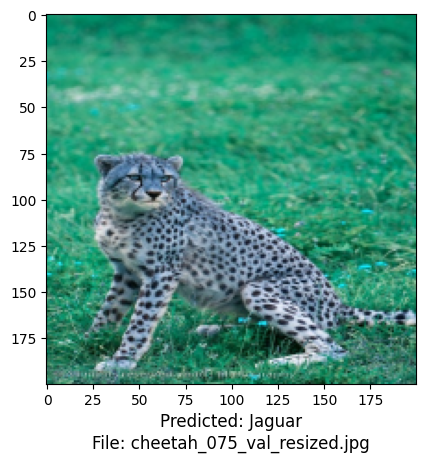

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
0.9981959


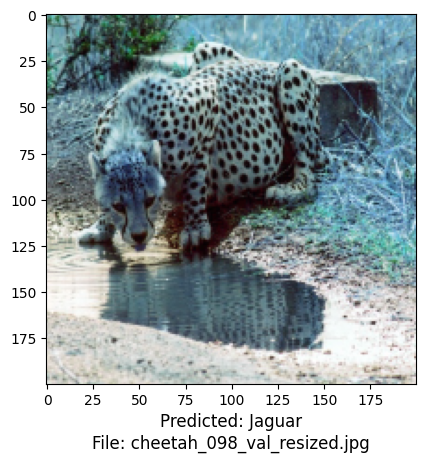

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
0.6674701


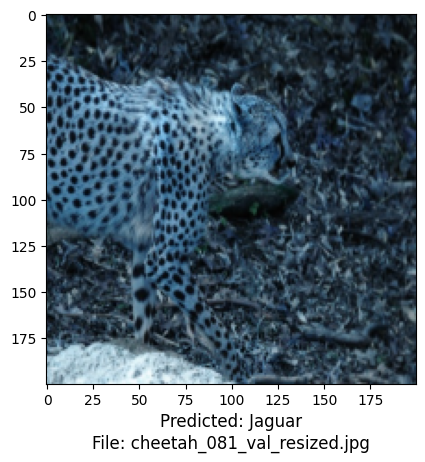

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
0.16446212


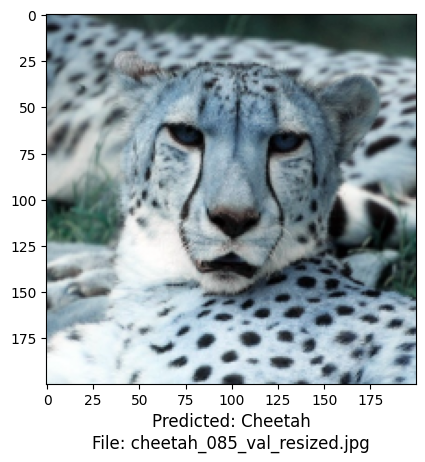

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
0.06905368


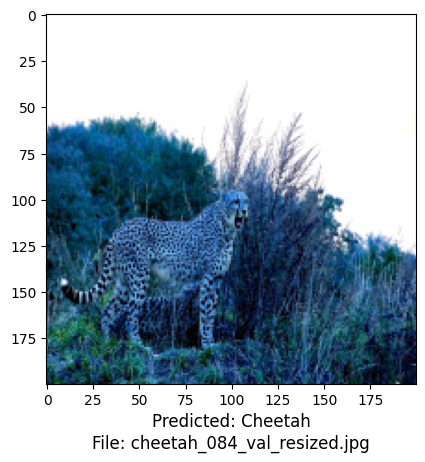

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
0.28843752


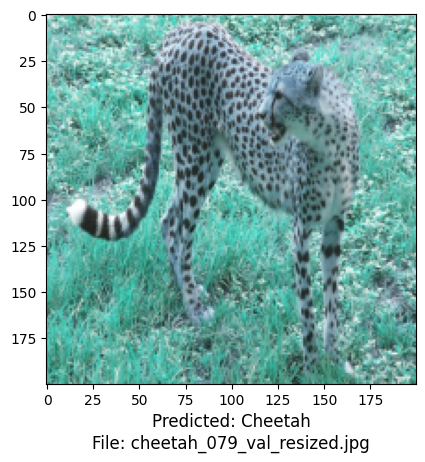

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
0.17265718


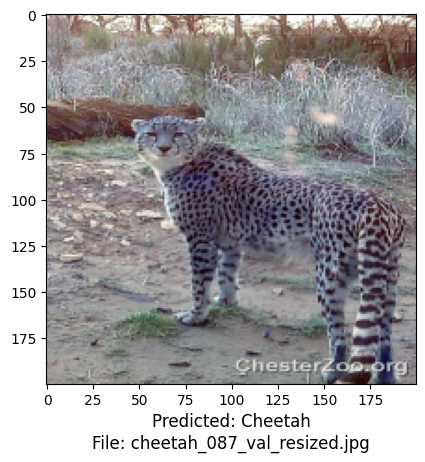

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
0.35858497


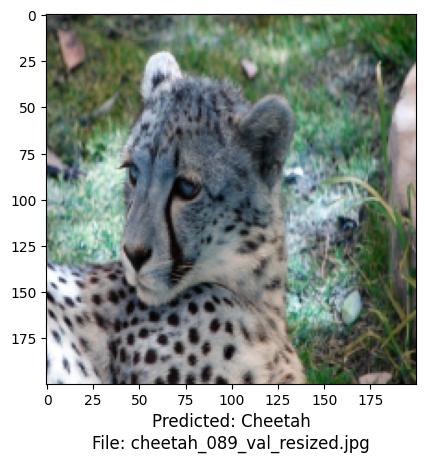

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
0.17310892


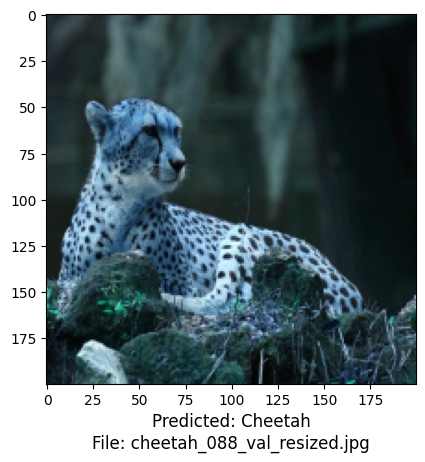

In [ ]:
directory_path = r'/content/drive/My Drive/CNN_BINARY_CLASSIFICATION/test/cheetah_validation_resized'
batch_predict(directory_path, model)